# Model for Pest and Disease Detection in Maize Plant
## School Project

### By Dominic Ocharo and Shadrack Onjiri

## Introduction
### This project showcases a significant milestone—a final model tailored for identifying pests and diseases in plants using the YOLOv8 format. The model was meticulously trained across 100 epochs, refining its capability to accurately detect and localize potential issues within plants.

### Timely identification and management of plant diseases and pests are vital for sustaining crop health and ensuring agricultural productivity. Utilizing the YOLOv8 format, this model plays a pivotal role in automating the process of recognizing and pinpointing potential problems in plants.

### It's crucial to note that this model represents a significant step in its development. The 100 training epochs mark an essential phase in initiating learning. However, to further bolster the model's accuracy and reliability in identifying a spectrum of plant-related issues, ongoing efforts will focus on additional training and optimization.



# Monitoring NVIDIA GPU Information in the PC

In [1]:
!nvidia-smi

Wed Nov  8 14:56:22 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 537.58                 Driver Version: 537.58       CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce GTX 1070 Ti   WDDM  | 00000000:01:00.0  On |                  N/A |
|  0%   42C    P8              13W / 180W |    425MiB /  8192MiB |      2%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# Checking GPU Availability in Python

### Verifying GPU availability and usage using Python.


In [2]:
import torch
torch.cuda.is_available()

True

## PyTorch GPU Checking

In [3]:
device = torch.cuda.current_device()

if device >= 0:
  print("The GPU is being used.")
else:
  print("The CPU is being used.")

print(torch.version.cuda)


The GPU is being used.
11.8


## TensorFlow GPU Checking

In [4]:
import tensorflow as tf
import torch

if torch.cuda.is_available():
    print("Available")
else:
    print("Not available")


Available


In [5]:
print(tf.config.list_physical_devices())

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]


In [6]:
devices = tf.config.list_physical_devices()

for device in devices:
  print(device)


PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')


### The provided output demonstrates the identification of GPU usage and CUDA version using PyTorch and the listing of physical devices with TensorFlow, indicating the presence of a GPU for computation if available.

# Installing Ultralytics Package

In [7]:
#!pip install ultralytics==8.0.20
# pip install --upgrade ultralytics
# pip install ultralytics


# Importing Required Libraries

In [8]:
## importing required libraries
import os
import shutil
import random
from IPython import display
display.clear_output()

from ultralytics import YOLO

from IPython.display import display, Image

!pip install tqdm --upgrade
from tqdm.notebook import tqdm

In [9]:
from IPython.display import Video
from PIL import Image

import csv
import matplotlib.pyplot as plt
import numpy as np

In [10]:
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.203  Python-3.8.18 torch-2.1.0 CUDA:0 (NVIDIA GeForce GTX 1070 Ti, 8192MiB)
Setup complete  (8 CPUs, 63.8 GB RAM, 201.6/237.4 GB disk)


# File Paths Configuration

## Setting the file paths for different directories in the project

In [14]:
testing_images_path = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\test_images"
testing_images_path2 = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2"
training_results_path = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results"
testing_videos_path = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos"
data_yaml_path = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\dataset.yaml"
tflite_testing_images = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\tflite_test_images"


# YOLO Training Process Overview

#### This code snippet demonstrates the training process for an object detection model using the YOLOV8 framework on an augmented dataset comprising 51,700 testing images.

#### These procedures were employed to train an object detection model specifically designed for the identification of pests and diseases in plants, utilizing the YOLO framework and the provided dataset.

### PLEASE NOTE THAT THE FINAL MODEL WAS TRAINED ACROSS 100 EPOCHS, REPRESENTING A CRUCIAL ITERATION IN ITS DEVELOPMENT AND ENHANCEMENT. THIS EXTENDED TRAINING PERIOD HAS CONTRIBUTED SIGNIFICANTLY TO THE MODEL'S ACCURACY AND CAPABILITY.


In [15]:
# !yolo task=detect mode=train model=yolov8s.pt data=C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_1\dataset.yaml epochs=5 imgsz=640 batch=8 project=C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_1\training_results name=pests_and_diseases plots=True device=0

from ultralytics import YOLO
 
# Load a model
model = YOLO('yolov8s.pt')

# Train the model
model.train(data=data_yaml_path, epochs=100, imgsz=640, batch=8, project=training_results_path, name='pests_and_diseases', plots=True, device=0)

New https://pypi.org/project/ultralytics/8.0.207 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.203  Python-3.8.18 torch-2.1.0 CUDA:0 (NVIDIA GeForce GTX 1070 Ti, 8192MiB)
engine\trainer: task=detect, mode=train, model=yolov8s.pt, data=C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\dataset.yaml, epochs=100, patience=50, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results, name=pests_and_diseases, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf

optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      1/100      2.15G      1.924      2.459      1.801          5        640: 100%|██████████| 7093/7093 [29:58<00:00,
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 145/145 [00:
                   all       2312       9882      0.436      0.404      0.375      0.189

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      2/100      2.15G      1.805      2.078      1.697          4        640: 100%|██████████| 7093/7093 [29:19<00:00,
                 Class     Images  Instances      Box(

     20/100      2.15G      1.478      1.348      1.423          3        640: 100%|██████████| 7093/7093 [29:24<00:00,
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 145/145 [00:
                   all       2312       9882       0.56      0.525      0.501      0.284

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     21/100      2.12G      1.468      1.329      1.416          6        640: 100%|██████████| 7093/7093 [29:25<00:00,
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 145/145 [00:
                   all       2312       9882      0.562      0.523      0.501      0.284

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     22/100      2.14G      1.457      1.318      1.408          4        640: 100%|██████████| 7093/7093 [29:26<00:00,
                 Class     Images  Instances      Box(P         

     42/100      2.15G      1.303       1.11      1.287          2        640: 100%|██████████| 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|█
                   all       2312       9882      0.552      0.532      0.496      0.282

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     43/100      2.14G      1.301      1.109      1.287          5        640: 100%|██████████| 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|█
                   all       2312       9882      0.554      0.531      0.496      0.282

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     44/100      2.15G      1.289      1.098      1.279          3        640: 100%|██████████| 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|█
                   all       2312       9882      0.552      0.531      0.496     

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 145/145 [00:27<00:00,  5.26it/s]
                   all       2312       9882      0.558       0.53      0.494      0.283

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     65/100      2.15G      1.165      0.967      1.204         23        640: 100%|██████████| 7093/7093 [29:02<00:00,  4.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 145/145 [00:27<00:00,  5.26it/s]
                   all       2312       9882      0.559       0.53      0.494      0.283
Stopping training early as no improvement observed in last 50 epochs. Best results observed at epoch 15, best model saved as best.pt.
To update EarlyStopping(patience=50) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.

65 epochs completed in 32.302 hours.
Optimizer stripped from C:\Use

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001BBF78161C0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
    

In [16]:
print("Done")

Done


# Confusion Matrix Visualization

### The Confusion Matrix was generated to provide insight into the model's accuracy in identifying different diseases in maize. It displays the predicted versus actual classifications, allowing an assessment of the model's strengths and weaknesses in disease recognition.


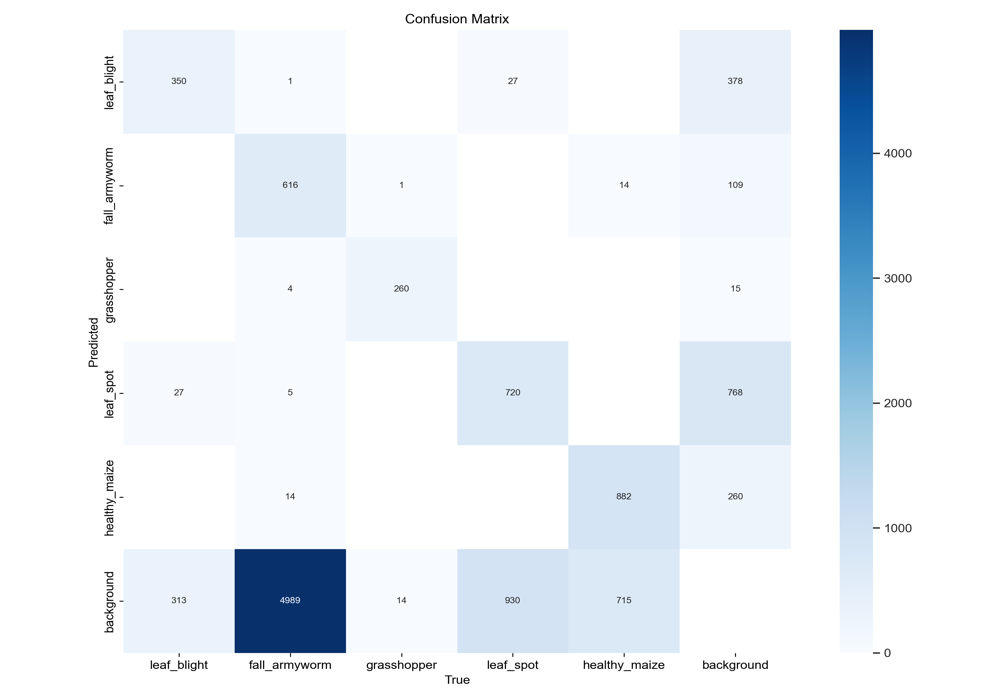

In [17]:
# Get the directory path
directory_path = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases"

first_png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][0]

# Convert the PNG image to the RGB mode
rgb_image = Image.open(os.path.join(directory_path, first_png_image)).convert("RGB").resize((1000, 700))

# Display the PNG image
display(rgb_image)


# Normalized Confusion Matrix

### In addition to the Confusion Matrix, the Normalized Confusion Matrix was created to showcase the model's performance in a normalized form. This matrix is valuable for understanding the distribution of correct and incorrect predictions, offering insights into the accuracy rates across different disease classes.

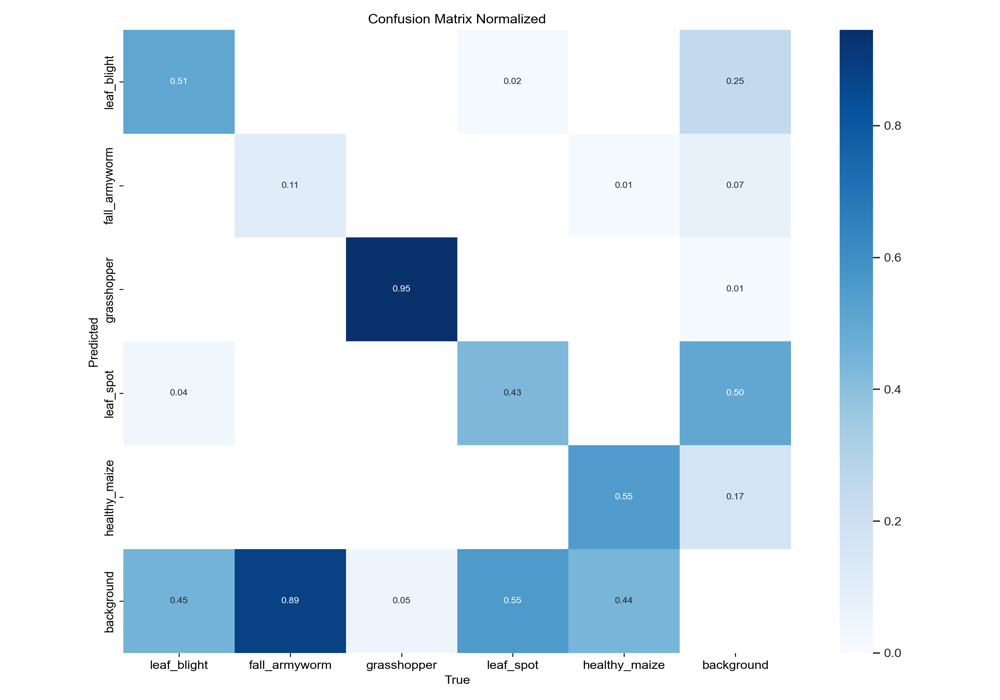

In [18]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][1]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


# Plotting Instances of Each Pest and Disease

### The number of instances for each pest and disease label, including Leaf Blight, Leaf Spot, Grasshopper, and Fall Armyworm, is plotted. This visualization provides an insight into the distribution of these labels within the dataset, showcasing the frequency or occurrence of each pest and disease, which is vital for understanding the dataset's class distribution.

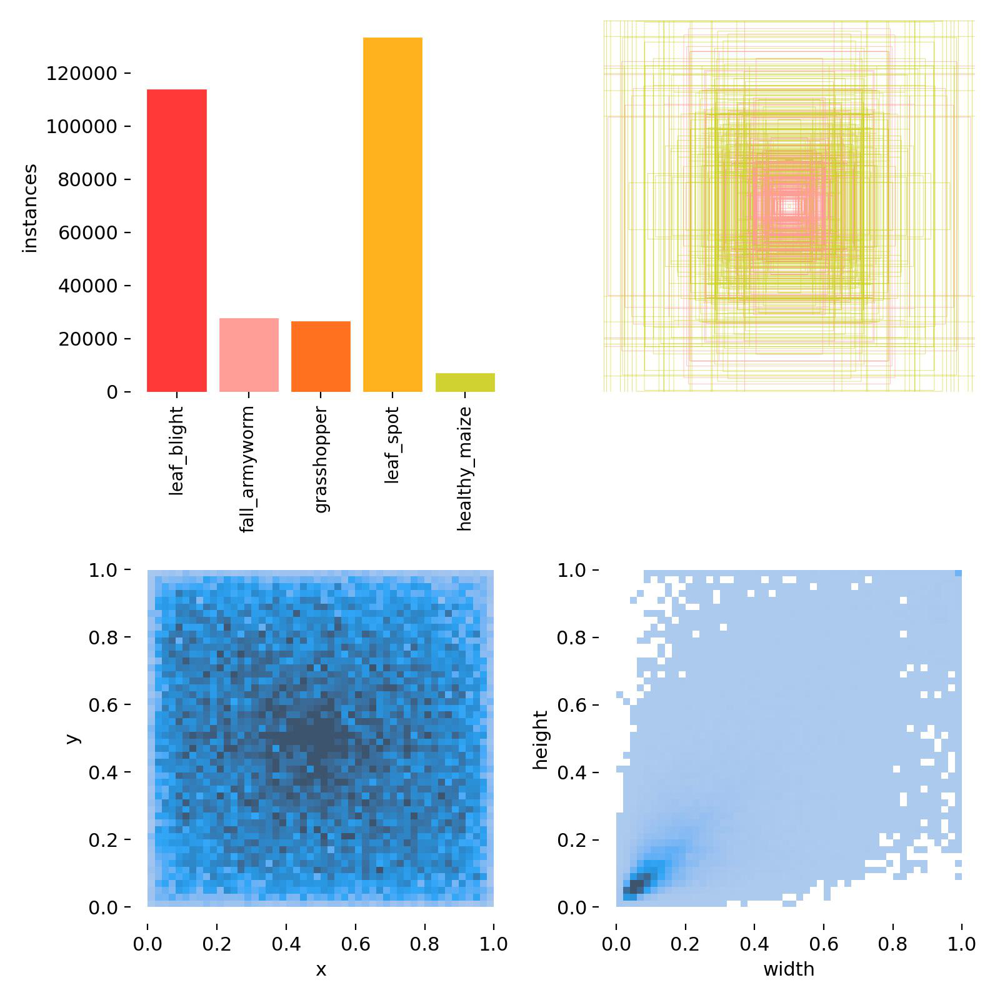

In [19]:
images = [f for f in os.listdir(directory_path) if f.endswith(".jpg") or f.endswith(".jpeg")]

image1 = images[0]
display(Image.open(os.path.join(directory_path, image1)))


# Assessing Model Confidence with F1 Score

### The F1 confidence curve provides a comprehensive view of the model's performance based on F1 scores across varying confidence thresholds. This curve showcases the relationship between the F1 score and the confidence levels used in predictions, aiding in determining an optimal threshold for decision-making in the model's classifications.

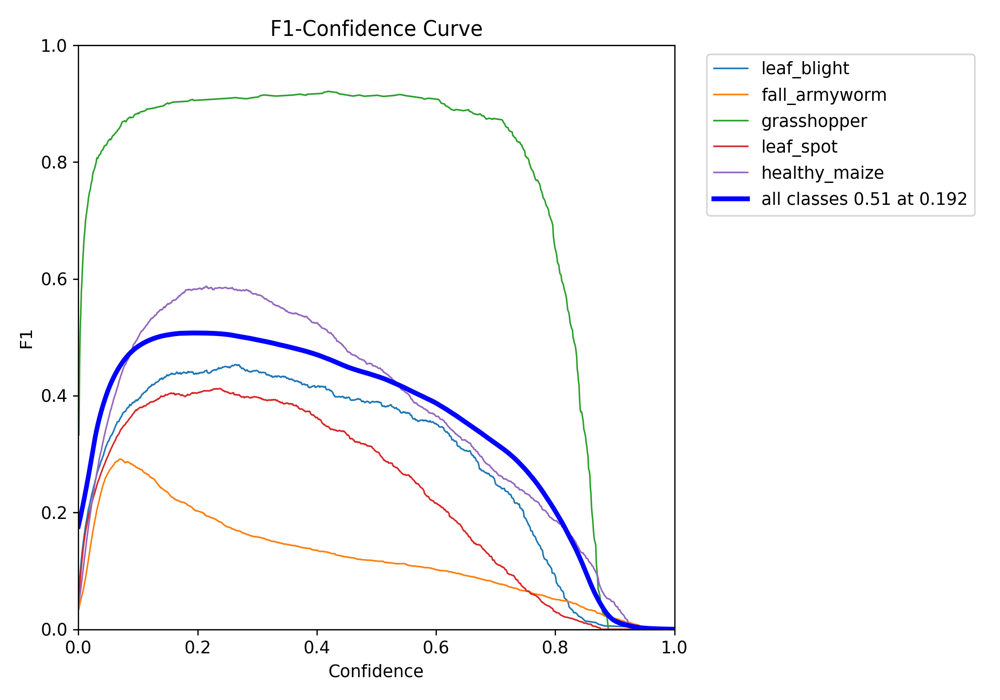

In [20]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][2]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


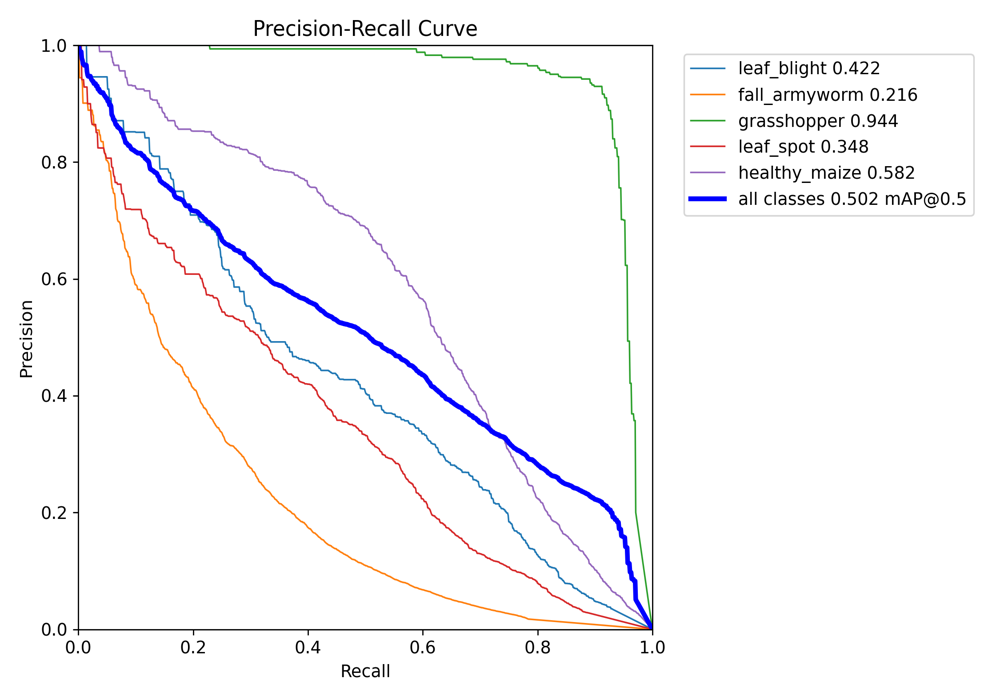

In [21]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][3]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


# Plotting the Precision against Confidence

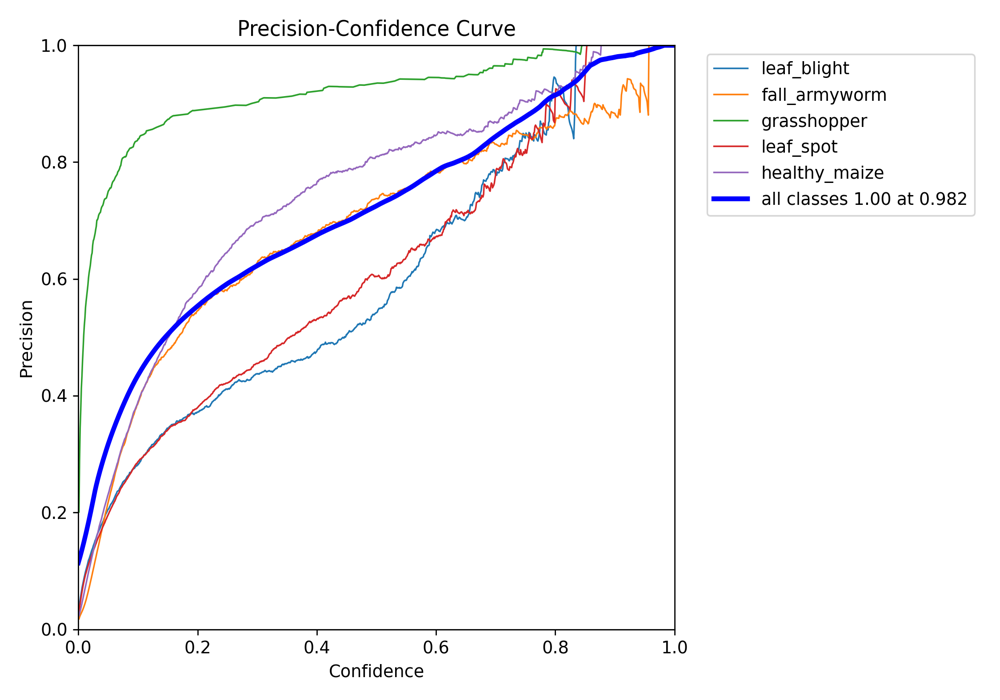

In [22]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][4]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


# Plotting the Losses

## Plotting the metrics/mAP50(B)


In [23]:
def load_map_scores(results_file):
  """Loads the mAP scores from the YOLOv8 training results file, handling errors gracefully.

  Args:
    results_file: The path to the YOLOv8 training results file.

  Returns:
    A list of mAP scores, or an empty list if the file does not contain valid mAP scores.
  """

  map_scores = []
  with open(results_file, 'r') as f:
    reader = csv.reader(f)
    for row in reader:
      try:
        map_scores.append(float(row[6]))
      except ValueError:
        # Handle the error gracefully.
        pass
  return map_scores

def plot_map_scores(map_scores, epochs, save_path):
  """Plots the mAP scores from YOLOv8 training results and saves it to the specified path.

  Args:
    map_scores: A list of mAP scores.
    epochs: A list of epochs.
    save_path: The path to save the plot to.
  """

  fig, ax = plt.subplots()
  ax.plot(epochs, map_scores)
  ax.set_xlabel('Epoch')
  ax.set_ylabel('mAP')
  ax.set_title('metrics/mAP50(B)')
  ax.grid(True)
  fig.savefig(save_path)
    
# Load the mAP scores from the YOLOv8 training results file, handling errors gracefully.
results = r'C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\results.csv'
map_scores = load_map_scores(results)

# If the list of mAP scores is empty, there was an error loading the file.
if not map_scores:
  print('Error loading the YOLOv8 training results file.')
  exit(1)

# Convert the epochs to a list of integers.
epochs = np.arange(len(map_scores)).astype(int)

# Save the plot to the specified folder.
save_path = r'C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\map_scores.png'

# Plot the map scores and save the plot to the specified folder.
plot_map_scores(map_scores, epochs, save_path)


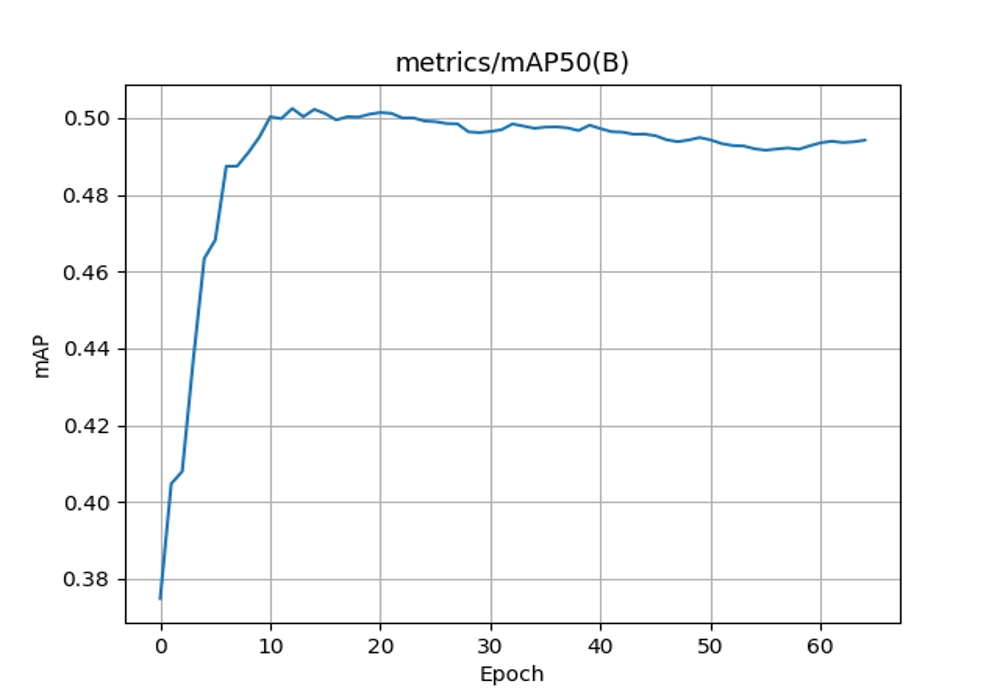

In [24]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][3]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)

## Plotting the metrics/mAP50-95(B)



In [25]:
def load_map_scores(results_file):
  """Loads the mAP scores from the YOLOv8 training results file, handling errors gracefully.

  Args:
    results_file: The path to the YOLOv8 training results file.

  Returns:
    A list of mAP scores, or an empty list if the file does not contain valid mAP scores.
  """

  map_scores = []
  with open(results_file, 'r') as f:
    reader = csv.reader(f)
    for row in reader:
      try:
        map_scores.append(float(row[7]))
      except ValueError:
        # Handle the error gracefully.
        pass
  return map_scores

def plot_map_scores(map_scores, epochs, save_path):
  """Plots the mAP scores from YOLOv8 training results and saves it to the specified path.

  Args:
    map_scores: A list of mAP scores.
    epochs: A list of epochs.
    save_path: The path to save the plot to.
  """

  fig, ax = plt.subplots()
  ax.plot(epochs, map_scores)
  ax.set_xlabel('Epoch')
  ax.set_ylabel('mAP')
  ax.set_title('metrics/mAP50-95(B)')
  ax.grid(True)
  fig.savefig(save_path)
    
# Load the mAP scores from the YOLOv8 training results file, handling errors gracefully.
results = r'C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\results.csv'
map_scores = load_map_scores(results)

# If the list of mAP scores is empty, there was an error loading the file.
if not map_scores:
  print('Error loading the YOLOv8 training results file.')
  exit(1)

# Convert the epochs to a list of integers.
epochs = np.arange(len(map_scores)).astype(int)

# Save the plot to the specified folder.
save_path = r'C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\map_scores1.png'

# Plot the map scores and save the plot to the specified folder.
plot_map_scores(map_scores, epochs, save_path)


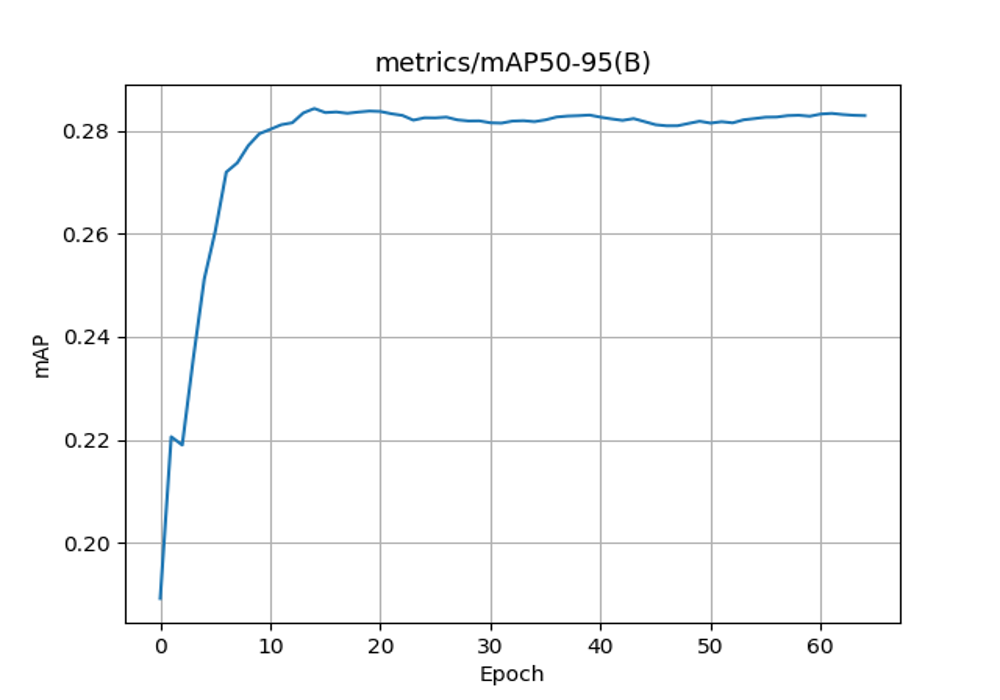

In [26]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][4]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


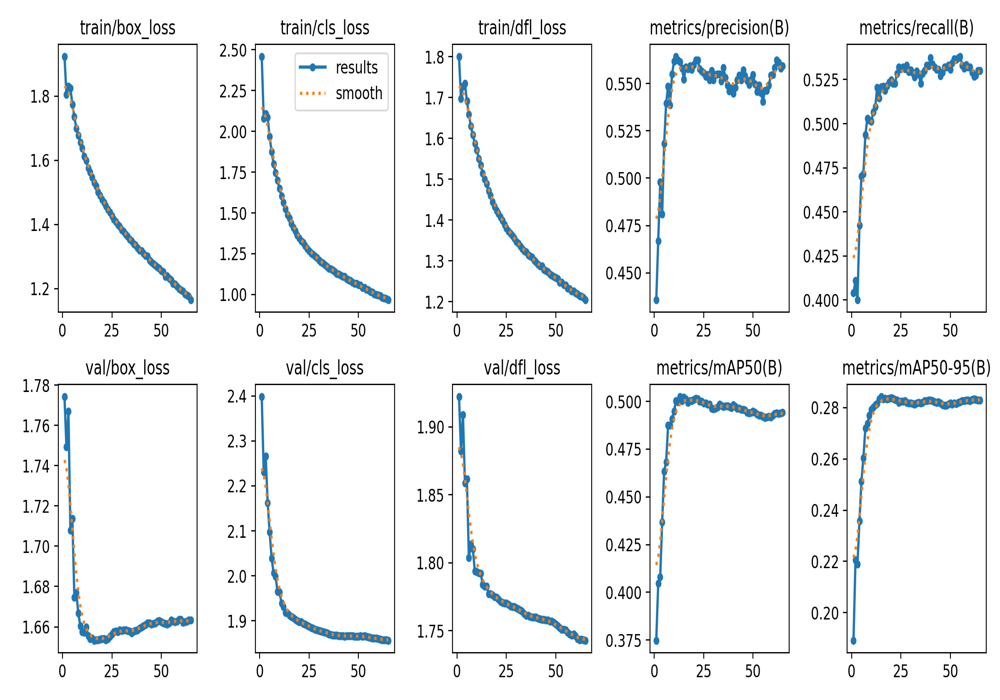

In [27]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][7]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


# Generating the Recall Confidence Curve

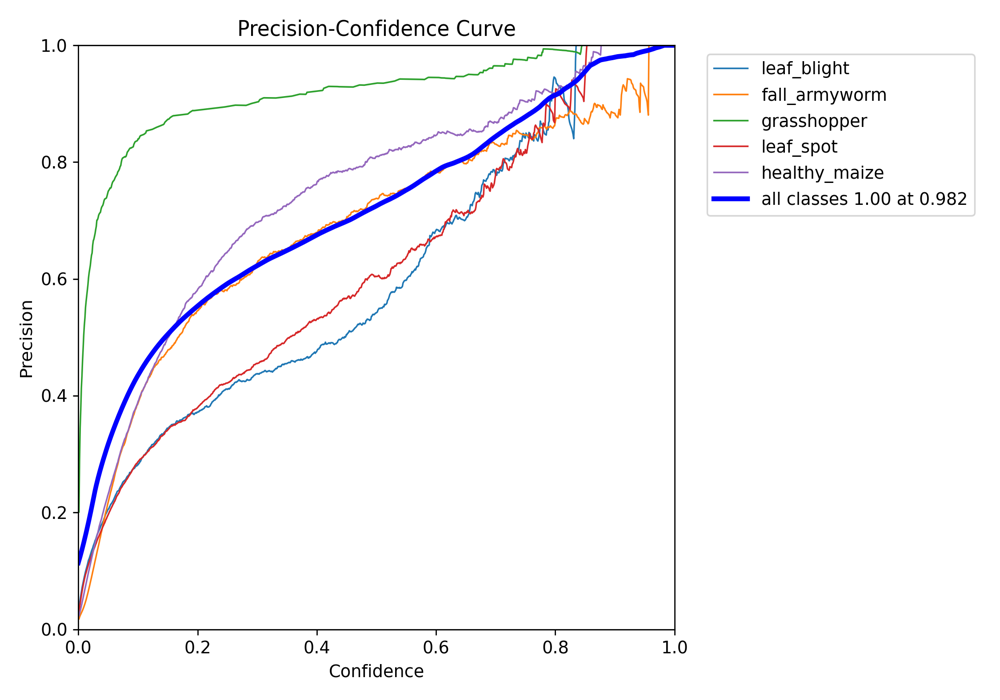

In [28]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][6]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


# Visualization of Labeled Validation Images

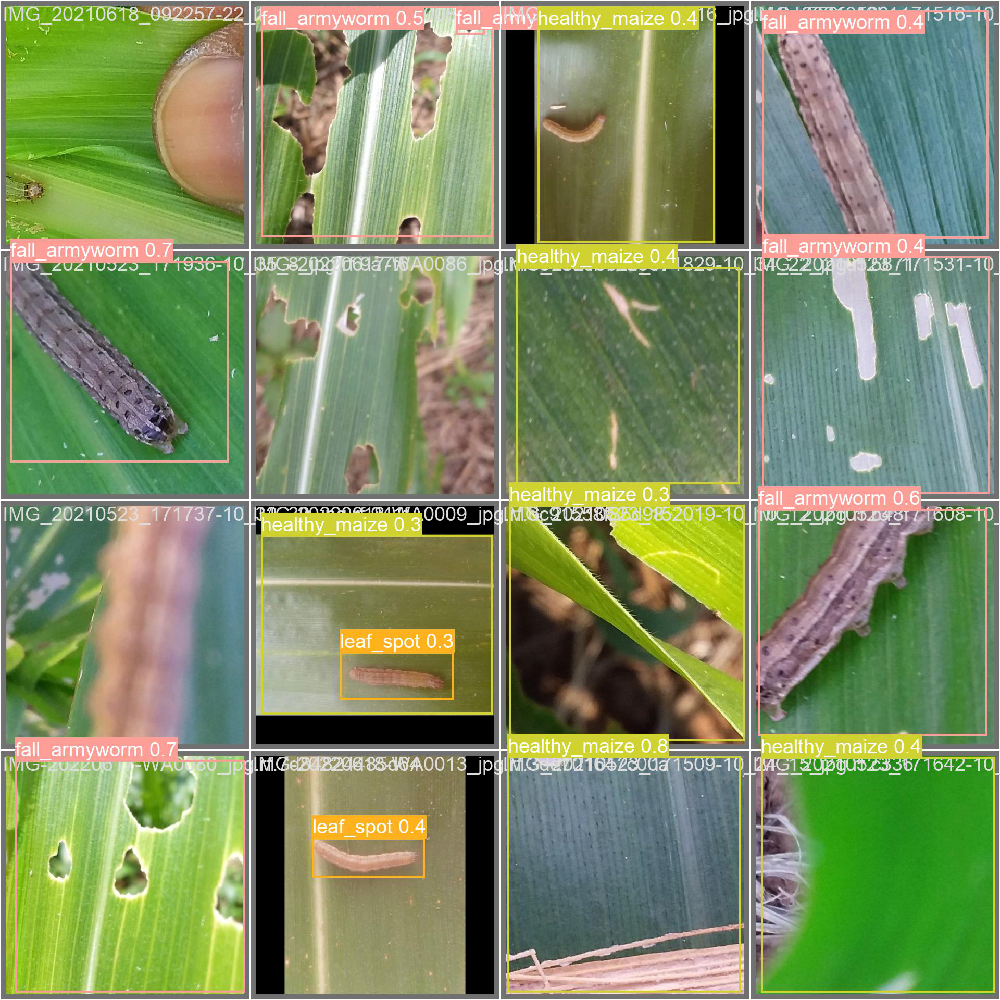

In [29]:
images = [f for f in os.listdir(directory_path) if f.endswith(".jpg") or f.endswith(".jpeg")]

image1 = images[8]
display(Image.open(os.path.join(directory_path, image1)))


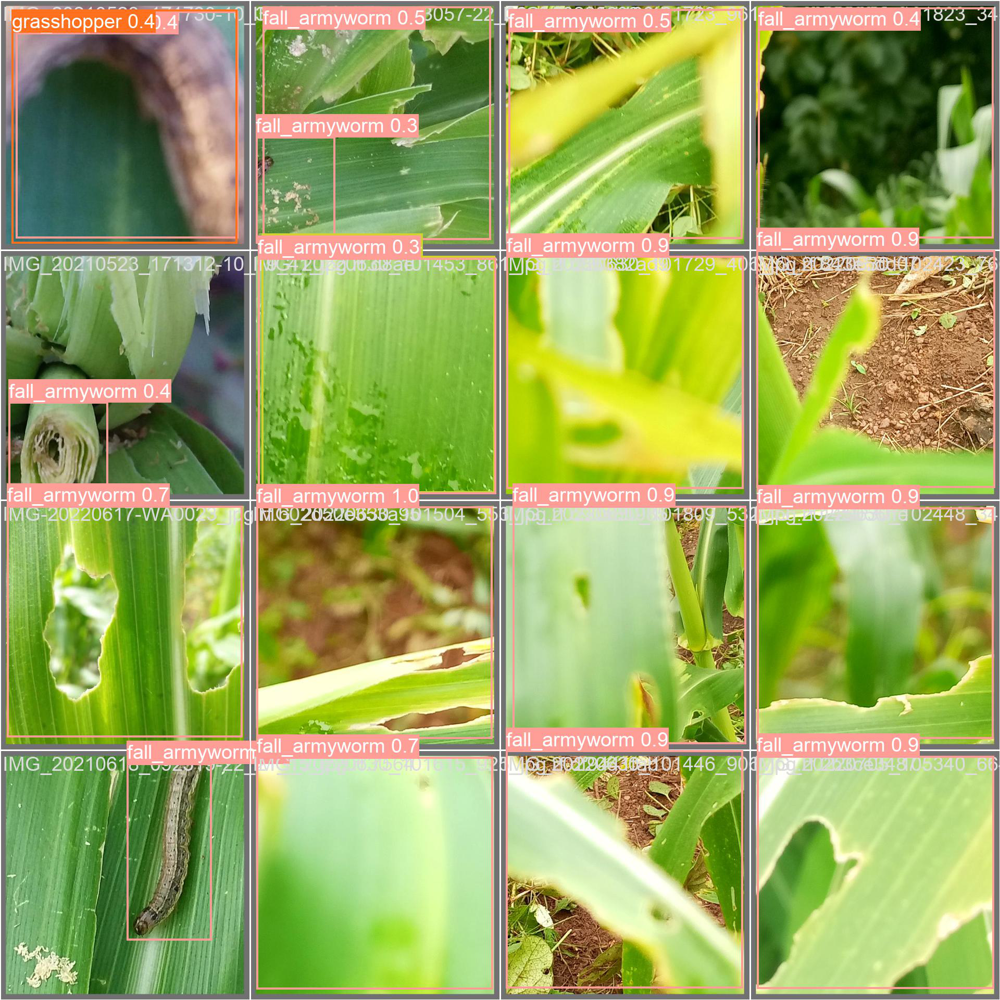

In [31]:
images = [f for f in os.listdir(directory_path) if f.endswith(".jpg") or f.endswith(".jpeg")]

image1 = images[10]
display(Image.open(os.path.join(directory_path, image1)))


# Model Inference on Testing Images

In [32]:
model_path = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best.pt"

In [33]:
# load the custom model
model = YOLO(model_path)
 
# Use the model to detect object
model.predict(source=testing_images_path, save=True)



image 1/18 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\test_images\fall-armyworm2__jpg.rf.6934080dfdd4b8ae1d3525fffc72ee8b.jpg: 640x640 1 fall_armyworm, 12.9ms
image 2/18 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\test_images\fall-armyworm67__jpg.rf.8237bc31e3f5c59259f74f97ec6fb1ab.jpg: 640x640 2 fall_armyworms, 19.3ms
image 3/18 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\test_images\fall-armyworm69__jpg.rf.127aa3e610b165ad365aa471d43d0cbb.jpg: 640x640 1 fall_armyworm, 19.4ms
image 4/18 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\test_images\fall-armyworm93__jpg.rf.e43bc9c8abdf616599ddad5f9f562c08.jpg: 640x640 1 fall_armyworm, 2 leaf_spots, 8.1ms
image 5/18 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\test_images\grasshoper161__jpg.rf.b4c2a89ff5ead0e2ef414499b87aa5bd.jpg: 640x640 3 grasshoppers, 12.0ms
image 6/18 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\test_imag

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'leaf_blight', 1: 'fall_armyworm', 2: 'grasshopper', 3: 'leaf_spot', 4: 'healthy_maize'}
 orig_img: array([[[  0,  44,  35],
         [  0,  46,  37],
         [  2,  49,  40],
         ...,
         [ 11,  62,  88],
         [  9,  59,  82],
         [  7,  57,  80]],
 
        [[  1,  48,  39],
         [  3,  50,  41],
         [  6,  53,  44],
         ...,
         [ 10,  61,  87],
         [  9,  58,  84],
         [  7,  57,  80]],
 
        [[  6,  53,  44],
         [  9,  56,  47],
         [ 14,  61,  52],
         ...,
         [ 12,  61,  87],
         [  8,  57,  83],
         [  7,  56,  82]],
 
        ...,
 
        [[ 28, 134, 175],
         [ 30, 137, 175],
         [ 32, 141, 179],
         ...,
         [ 57, 126, 153],
         [ 58, 127, 154],
         [ 56, 127, 154]],
 
        [[ 26, 132, 173],
         [ 29, 1

In [44]:
# load the custom model
model = YOLO(model_path)
 
# Use the model to detect object
model.predict(source=testing_images_path2, save=True)



image 1/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\0-98791500_1568112454_6234_jpg.rf.3c227e523f592397c456932db200f02e.jpg: 640x640 2 fall_armyworms, 16.2ms
image 2/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\010-1_jpg.rf.840b18154859949e714823a028257d5c.jpg: 640x640 4 fall_armyworms, 1 grasshopper, 12.0ms
image 3/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\04-galerie05_worm_740x416_jpeg.rf.84e40f130b9df5371f21601e087d434b.jpg: 640x640 1 fall_armyworm, 16.1ms
image 4/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\11213_2019_9489_Fig11_HTML_jpg.rf.ab6a7bf2b4dd6bca8fb56fd698b550d3.jpg: 640x640 (no detections), 8.2ms
image 5/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200612_104046_jpg.rf.f285dbac38aa9ef400d13ad9e3d83d19.jpg: 640x640 1 healthy_maize, 15.6ms
image 6/280 C:\Users\lawrenceJICA\D

image 45/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_080726_jpg.rf.bc457d687789c8e5fdd4e4d6a956c9d1.jpg: 640x640 (no detections), 12.7ms
image 46/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_080728_jpg.rf.1a19e63bf78304f28f22f761b3888905.jpg: 640x640 1 fall_armyworm, 11.1ms
image 47/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_080730_jpg.rf.673075617c3f870152daa4c738de165d.jpg: 640x640 1 fall_armyworm, 10.9ms
image 48/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_080734_jpg.rf.1e1860cf1c4ee39fa67db6bc98a65ec2.jpg: 640x640 (no detections), 13.7ms
image 49/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_080736_jpg.rf.43e46aa8f1d50ff8c30b540a4a629a96.jpg: 640x640 (no detections), 11.5ms
image 50/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\m

image 90/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_081003_jpg.rf.b7ef63c248b0dabd7199ab336859b781.jpg: 640x640 (no detections), 14.1ms
image 91/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_081008_jpg.rf.7bafcc5620452e05f1bc8219bb30d620.jpg: 640x640 (no detections), 10.8ms
image 92/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_081013_jpg.rf.ef9092e40c909df5affc7a2c4a1910dc.jpg: 640x640 (no detections), 11.3ms
image 93/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_081016_jpg.rf.b15412e2a3fad62a199280691dbd74bf.jpg: 640x640 (no detections), 16.2ms
image 94/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_081018_jpg.rf.ac6701b6616601145c330d4753d3e601.jpg: 640x640 (no detections), 11.0ms
image 95/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\m

image 134/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_081258_jpg.rf.54e67068bd52f05d9fd6fa4bb0d23cc5.jpg: 640x640 (no detections), 12.0ms
image 135/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_081301_jpg.rf.e21a25a64a549ada61183cb604394e09.jpg: 640x640 (no detections), 12.1ms
image 136/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_081306_jpg.rf.ff972427b1932f040bb6be11c25b60b1.jpg: 640x640 1 fall_armyworm, 14.9ms
image 137/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_081309_jpg.rf.d887854a49086836ba4fbb1affdb80c1.jpg: 640x640 (no detections), 11.9ms
image 138/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200701_081312_jpg.rf.bf4db9b86eb79bc8629793904183d0a0.jpg: 640x640 (no detections), 10.8ms
image 139/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_pro

image 178/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200727_100600_jpg.rf.f9a1a1182b7f1353cd42c011c3e601ff.jpg: 640x640 4 healthy_maizes, 12.6ms
image 179/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200727_100601_jpg.rf.10d0f442bbbcd6fa3cf1f97091b84dd0.jpg: 640x640 5 healthy_maizes, 15.2ms
image 180/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200727_100602_jpg.rf.cb0a2981b70db0c55530bf3d850d5f19.jpg: 640x640 5 healthy_maizes, 8.0ms
image 181/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200727_100603_jpg.rf.4417838ec4c52ea2b4301d27b0f4d805.jpg: 640x640 3 healthy_maizes, 12.0ms
image 182/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\20200727_100604_jpg.rf.8019cf98ecc473ad9207abddc9780912.jpg: 640x640 3 healthy_maizes, 7.8ms
image 183/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_

image 221/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\corn-leaf-damaged-by-fall-armyworm-spodoptera-frugiperda-corn-leaves-attacked-by-worms-in-maize-stock-images_csp71852458_jpg.rf.178f999cf16b0b4d43083d129d919aa0.jpg: 640x640 (no detections), 13.4ms
image 222/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\csm_News_59_18_ad64b651c8_jpg.rf.ca89d6828cfea83834d8064b31bab3ad.jpg: 640x640 4 fall_armyworms, 15.8ms
image 223/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\csm_Science_2_21_Fall-armyworm_shutterstock_1473209930_Kopie_337591fb46_jpg.rf.33c867ae482a0ad6113fb1b0414e8a54.jpg: 640x640 5 leaf_spots, 11.1ms
image 224/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\discover_jpg.rf.4b7f65d5583b2781ef092d498d187e32.jpg: 640x640 1 fall_armyworm, 10.6ms
image 225/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_imag

image 264/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\images--6-_jpg.rf.80d7ba20203c35ca13f88179597b43ca.jpg: 640x640 1 fall_armyworm, 12.9ms
image 265/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\images--7-_jpg.rf.e81cfbadcbe5e039fb1616f37032b485.jpg: 640x640 1 fall_armyworm, 11.0ms
image 266/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\images--8-_jpg.rf.b97d81c7a6806736f324833dcb6c1441.jpg: 640x640 1 fall_armyworm, 16.0ms
image 267/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\images--9-_jpg.rf.f6fc1a5792859ff7833bba622ea1b064.jpg: 640x640 1 fall_armyworm, 13.6ms
image 268/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\images_jpg.rf.0a19b1e7265c8a6a25a752fa34a2d66e.jpg: 640x640 (no detections), 10.9ms
image 269/280 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\testing_images2\

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'leaf_blight', 1: 'fall_armyworm', 2: 'grasshopper', 3: 'leaf_spot', 4: 'healthy_maize'}
 orig_img: array([[[ 27,  51,  33],
         [ 20,  48,  29],
         [ 10,  49,  27],
         ...,
         [ 64, 144, 107],
         [ 70, 147, 110],
         [ 68, 145, 108]],
 
        [[ 29,  53,  35],
         [ 22,  50,  31],
         [ 12,  51,  29],
         ...,
         [ 66, 144, 107],
         [ 68, 145, 108],
         [ 65, 142, 105]],
 
        [[ 28,  54,  36],
         [ 22,  52,  33],
         [ 15,  53,  31],
         ...,
         [ 66, 143, 109],
         [ 68, 142, 108],
         [ 63, 137, 103]],
 
        ...,
 
        [[ 11,  65,  52],
         [ 10,  66,  53],
         [ 11,  70,  56],
         ...,
         [ 22,  92,  62],
         [ 25,  95,  65],
         [ 27,  97,  67]],
 
        [[ 11,  64,  51],
         [ 11,  


# Visualization of predicted Testing Images

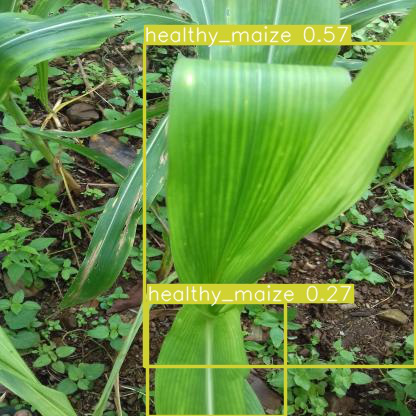

In [46]:
# Get the directory path
dpath = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\runs\detect\predict"
dpath2 = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\runs\detect\predict2"

images = [f for f in os.listdir(dpath2) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath2, images[200])))


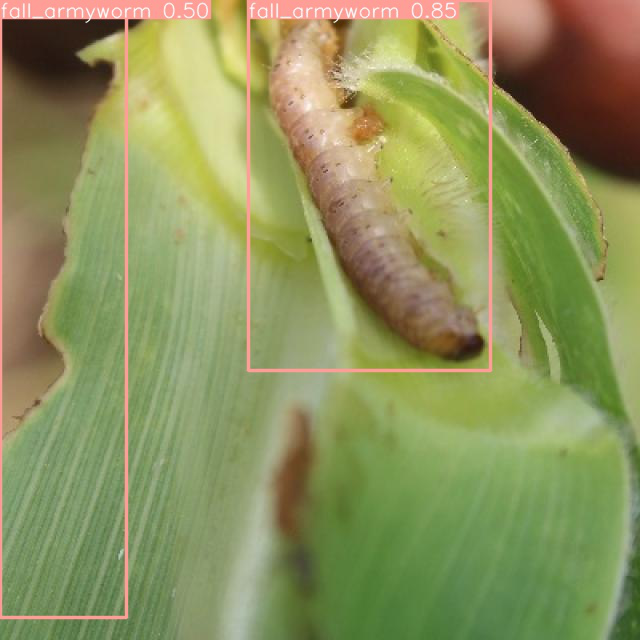

In [47]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[1])))

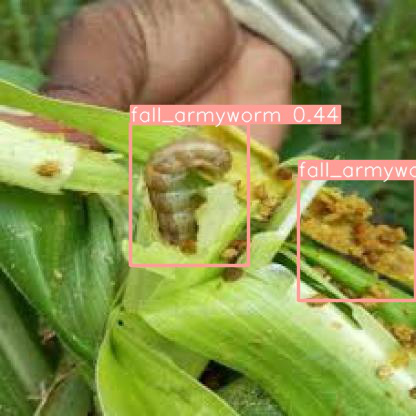

In [48]:
images = [f for f in os.listdir(dpath2) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath2, images[255])))

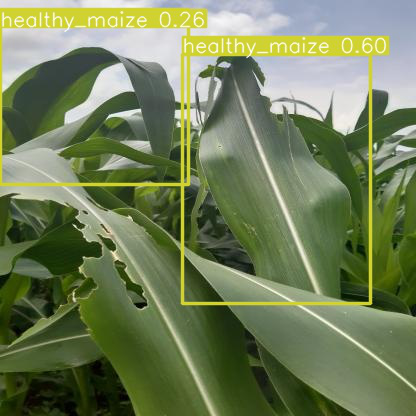

In [49]:
images = [f for f in os.listdir(dpath2) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath2, images[23])))

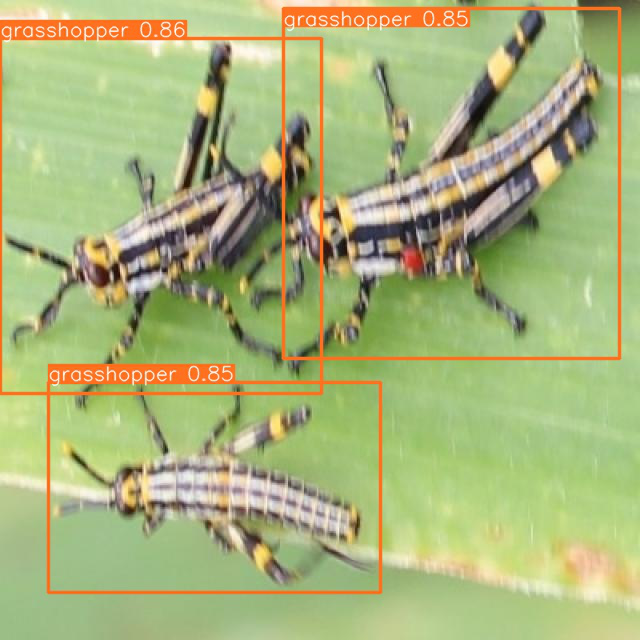

In [50]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[4])))

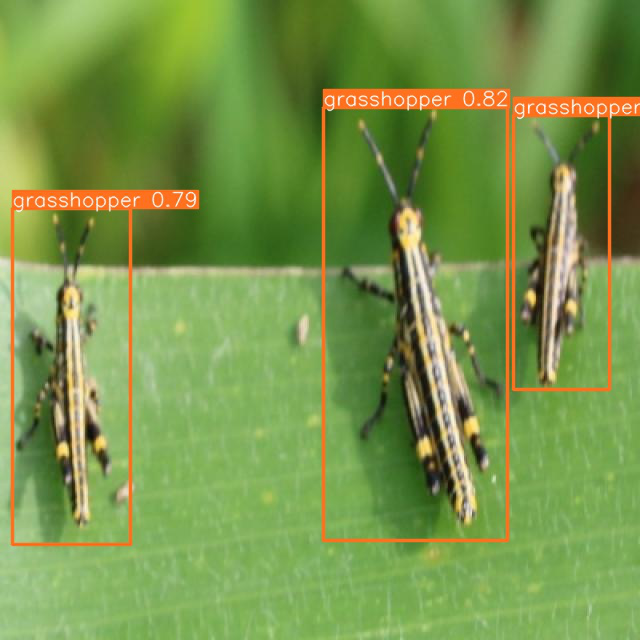

In [51]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[5])))

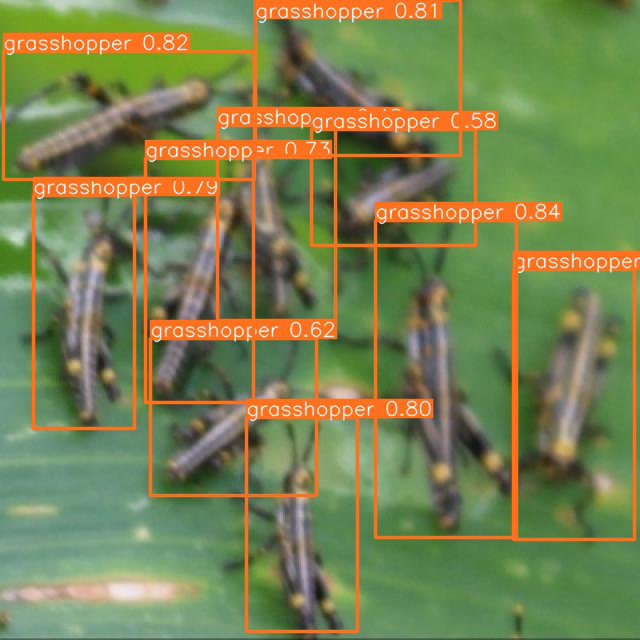

In [52]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[8])))

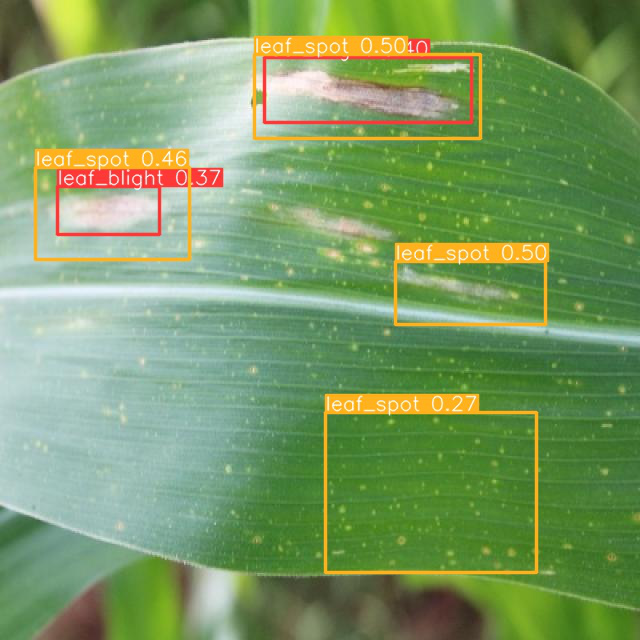

In [53]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[10])))

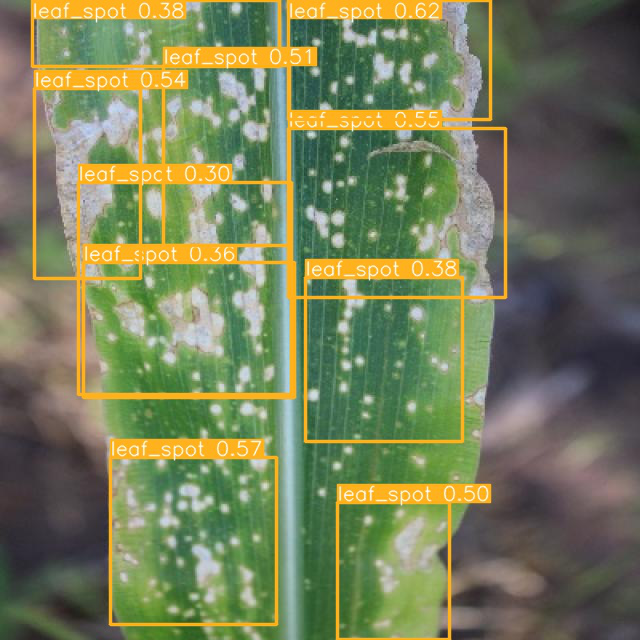

In [54]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[15])))

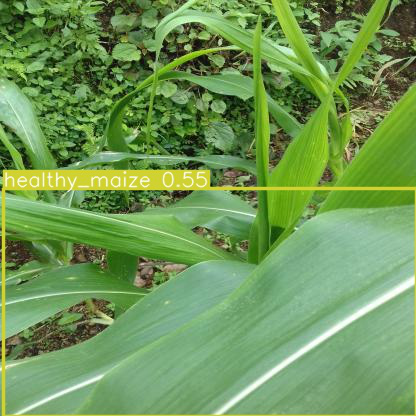

In [55]:
images = [f for f in os.listdir(dpath2) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath2, images[145])))

# Inferencing on video


In [56]:
# For video
from ultralytics import YOLO
 
# Load custom trained YOLOv8 model
model = YOLO(model_path)
 
# Use the model to detect object
model.predict(source=testing_videos_path, save=True)



WARNING  inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/8 (1/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 44.8ms
video 1/8 (2/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 12.0ms
video 1/8 (3/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 11.7ms
video 1/8 (4/234) C:\Users\lawrenceJICA\Desktop

video 1/8 (57/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 4.4ms
video 1/8 (58/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 10.6ms
video 1/8 (59/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 11.6ms
video 1/8 (60/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 10.3ms
video 1/8 (61/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 11.1ms
video 1/8 (62/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 3 fall_armyworms, 10.6ms
video 1/8 (63/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 3 fall_armyworms, 11.6ms
video 1/8 (64/234) C:\Users\lawrenc

video 1/8 (117/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 3 fall_armyworms, 10.1ms
video 1/8 (118/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 3 fall_armyworms, 2.9ms
video 1/8 (119/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 3 fall_armyworms, 10.3ms
video 1/8 (120/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 3 fall_armyworms, 9.8ms
video 1/8 (121/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 3 fall_armyworms, 16.8ms
video 1/8 (122/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 3 fall_armyworms, 8.0ms
video 1/8 (123/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 3 fall_armyworms, 10.0ms
video 1/8 (124/234) C:\Users\l

video 1/8 (177/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 7.2ms
video 1/8 (178/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 10.0ms
video 1/8 (179/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 16.4ms
video 1/8 (180/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 9.4ms
video 1/8 (181/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 9.6ms
video 1/8 (182/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 3.5ms
video 1/8 (183/234) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm1.mp4: 384x640 2 fall_armyworms, 11.6ms
video 1/8 (184/234) C:\Users\la

video 2/8 (3/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 10.7ms
video 2/8 (4/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 11.7ms
video 2/8 (5/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 9.7ms
video 2/8 (6/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 9.6ms
video 2/8 (7/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 2.8ms
video 2/8 (8/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 2.8ms
video 2/8 (9/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 10.7ms
video 2/8 (10/501) C:\Users\lawrenceJICA\Desk

video 2/8 (63/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 10.0ms
video 2/8 (64/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 15.3ms
video 2/8 (65/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 7.7ms
video 2/8 (66/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 3.1ms
video 2/8 (67/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 5.8ms
video 2/8 (68/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 10.0ms
video 2/8 (69/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 11.7ms
video 2/8 (70/501) C:\Users\lawrenceJ

video 2/8 (123/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 4.2ms
video 2/8 (124/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 3.1ms
video 2/8 (125/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 2.4ms
video 2/8 (126/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 10.7ms
video 2/8 (127/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 10.6ms
video 2/8 (128/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 10.8ms
video 2/8 (129/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 2.8ms
video 2/8 (130/501) C:\Users\lawrence

video 2/8 (183/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 10.8ms
video 2/8 (184/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 10.6ms
video 2/8 (185/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 10.6ms
video 2/8 (186/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 3.2ms
video 2/8 (187/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 10.7ms
video 2/8 (188/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 10.7ms
video 2/8 (189/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 10.7ms
video 2/8 (190/501) C:\Users

video 2/8 (243/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 10.2ms
video 2/8 (244/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 11.6ms
video 2/8 (245/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 11.5ms
video 2/8 (246/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 3.4ms
video 2/8 (247/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 3.5ms
video 2/8 (248/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 3 fall_armyworms, 10.7ms
video 2/8 (249/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 10.7ms
video 2/8 (250/501) C:\Users\

video 2/8 (303/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 8.2ms
video 2/8 (304/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 12.5ms
video 2/8 (305/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 9.0ms
video 2/8 (306/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 4.6ms
video 2/8 (307/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 10.6ms
video 2/8 (308/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 14.7ms
video 2/8 (309/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 2 fall_armyworms, 8.3ms
video 2/8 (310/501) C:\Users\la

video 2/8 (363/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 9.8ms
video 2/8 (364/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 11.6ms
video 2/8 (365/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 9.7ms
video 2/8 (366/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 3.8ms
video 2/8 (367/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 3.4ms
video 2/8 (368/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 10.7ms
video 2/8 (369/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 10.7ms
video 2/8 (370/501) C:\Users\lawrenceJ

video 2/8 (423/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 10.1ms
video 2/8 (424/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 10.8ms
video 2/8 (425/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 15.9ms
video 2/8 (426/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 16.0ms
video 2/8 (427/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 8.6ms
video 2/8 (428/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 4.8ms
video 2/8 (429/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 9.8ms
video 2/8 (430/501) C:\Users\lawrence

video 2/8 (483/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 4.6ms
video 2/8 (484/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 10.7ms
video 2/8 (485/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 6.3ms
video 2/8 (486/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 2.8ms
video 2/8 (487/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 11.6ms
video 2/8 (488/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 11.7ms
video 2/8 (489/501) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\armyworm2.mp4: 384x640 1 fall_armyworm, 10.1ms
video 2/8 (490/501) C:\Users\lawrence

video 3/8 (42/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 5.3ms
video 3/8 (43/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 4.0ms
video 3/8 (44/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 3.6ms
video 3/8 (45/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 3.2ms
video 3/8 (46/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 8.5ms
video 3/8 (47/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 3.6ms
video 3/8 (48/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 6.1ms
video 3/8 (49/503) C:\Users

video 3/8 (101/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 9.0ms
video 3/8 (102/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 8.2ms
video 3/8 (103/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 8.2ms
video 3/8 (104/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 5.0ms
video 3/8 (105/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 13.3ms
video 3/8 (106/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 14.3ms
video 3/8 (107/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 16.7ms
video 3/8 (108/50

video 3/8 (160/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 10.7ms
video 3/8 (161/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 10.8ms
video 3/8 (162/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 11.6ms
video 3/8 (163/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 11.6ms
video 3/8 (164/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 10.7ms
video 3/8 (165/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 11.7ms
video 3/8 (166/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 10.7ms
video 3/8 (16

video 3/8 (219/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 14.5ms
video 3/8 (220/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 6.7ms
video 3/8 (221/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 6.9ms
video 3/8 (222/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 7.9ms
video 3/8 (223/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 11.4ms
video 3/8 (224/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 8.6ms
video 3/8 (225/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 10.5ms
video 3/8 (226/503)

video 3/8 (278/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 fall_armyworm, 1 grasshopper, 4.8ms
video 3/8 (279/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 3.0ms
video 3/8 (280/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 fall_armyworm, 1 grasshopper, 3.1ms
video 3/8 (281/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 11.5ms
video 3/8 (282/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 10.7ms
video 3/8 (283/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 fall_armyworm, 10.2ms
video 3/8 (284/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 fall_armywor

video 3/8 (336/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 2 grasshoppers, 4.9ms
video 3/8 (337/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 3.3ms
video 3/8 (338/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 3.1ms
video 3/8 (339/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 3.6ms
video 3/8 (340/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 10.7ms
video 3/8 (341/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 10.7ms
video 3/8 (342/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 2 grasshoppers, 10.3ms
video 3/8 (343/503) C:\User

video 3/8 (395/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 fall_armyworm, 1 grasshopper, 11.1ms
video 3/8 (396/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 3.6ms
video 3/8 (397/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 (no detections), 9.8ms
video 3/8 (398/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 6.3ms
video 3/8 (399/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 3.0ms
video 3/8 (400/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 3.4ms
video 3/8 (401/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 1 grasshopper, 10.7ms
video 3/8 (

video 3/8 (454/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 2 grasshoppers, 8.3ms
video 3/8 (455/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 4 grasshoppers, 11.7ms
video 3/8 (456/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 3 grasshoppers, 15.6ms
video 3/8 (457/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 3 grasshoppers, 8.6ms
video 3/8 (458/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 2 grasshoppers, 4.9ms
video 3/8 (459/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 3 grasshoppers, 3.2ms
video 3/8 (460/503) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper1.mp4: 384x640 3 grasshoppers, 3.4ms
video 3/8 (461/503) C:\Us

video 4/8 (9/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.0ms
video 4/8 (10/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 11.5ms
video 4/8 (11/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 12.6ms
video 4/8 (12/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 2.9ms
video 4/8 (13/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 3.6ms
video 4/8 (14/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 10.6ms
video 4/8 (15/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 11.7ms
video 4/8 (16/2834) C:\Us

video 4/8 (68/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.2ms
video 4/8 (69/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.3ms
video 4/8 (70/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 10.6ms
video 4/8 (71/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (72/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (73/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.8ms
video 4/8 (74/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.8ms
video 4/8 (75/2834) C:\Users\

video 4/8 (127/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 11.7ms
video 4/8 (128/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 3.6ms
video 4/8 (129/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 10.8ms
video 4/8 (130/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 3.1ms
video 4/8 (131/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 4.1ms
video 4/8 (132/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 10.7ms
video 4/8 (133/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 10.7ms
video 4/8 (134/2

video 4/8 (186/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (187/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 11.7ms
video 4/8 (188/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.7ms
video 4/8 (189/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 9.1ms
video 4/8 (190/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.0ms
video 4/8 (191/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 8.2ms
video 4/8 (192/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 10.7ms
video 4/8 (193/2834)

video 4/8 (245/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.2ms
video 4/8 (246/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 3.7ms
video 4/8 (247/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.8ms
video 4/8 (248/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 11.7ms
video 4/8 (249/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 10.7ms
video 4/8 (250/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 4.0ms
video 4/8 (251/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (252/2834

video 4/8 (304/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 14.3ms
video 4/8 (305/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 12.0ms
video 4/8 (306/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 10.2ms
video 4/8 (307/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 7.0ms
video 4/8 (308/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 11.0ms
video 4/8 (309/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 5.9ms
video 4/8 (310/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 10.5ms
video 4/8 (311/

video 4/8 (363/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.9ms
video 4/8 (364/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (365/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.8ms
video 4/8 (366/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.6ms
video 4/8 (367/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 10.6ms
video 4/8 (368/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 3.3ms
video 4/8 (369/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 3.2ms
video 4/8 (370/2834)

video 4/8 (422/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 6.8ms
video 4/8 (423/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.4ms
video 4/8 (424/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.9ms
video 4/8 (425/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (426/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.6ms
video 4/8 (427/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.6ms
video 4/8 (428/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 14.7ms
video 4/8 (429/2834) C:\U

video 4/8 (481/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.7ms
video 4/8 (482/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.5ms
video 4/8 (483/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.6ms
video 4/8 (484/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 15.8ms
video 4/8 (485/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.7ms
video 4/8 (486/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.6ms
video 4/8 (487/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 7.2ms
video 4/8 (488/2834) C:

video 4/8 (540/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (541/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.6ms
video 4/8 (542/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.7ms
video 4/8 (543/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.4ms
video 4/8 (544/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 7.2ms
video 4/8 (545/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.4ms
video 4/8 (546/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.7ms
video 4/8 (547/2834) C:\U

video 4/8 (599/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (600/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.6ms
video 4/8 (601/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.6ms
video 4/8 (602/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.5ms
video 4/8 (603/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.2ms
video 4/8 (604/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 15.9ms
video 4/8 (605/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.0ms
video 4/8 (606/2834) C:

video 4/8 (658/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.9ms
video 4/8 (659/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.6ms
video 4/8 (660/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.4ms
video 4/8 (661/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 12.4ms
video 4/8 (662/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.4ms
video 4/8 (663/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.0ms
video 4/8 (664/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.6ms
video 4/8 (665/2834) C:

video 4/8 (717/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (718/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.5ms
video 4/8 (719/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (720/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (721/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 14.8ms
video 4/8 (722/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.4ms
video 4/8 (723/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 7.1ms
video 4/8 (724/2834) C:\Us

video 4/8 (776/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.8ms
video 4/8 (777/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.6ms
video 4/8 (778/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.4ms
video 4/8 (779/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.4ms
video 4/8 (780/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 14.2ms
video 4/8 (781/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.5ms
video 4/8 (782/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (783/2834) C

video 4/8 (835/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.5ms
video 4/8 (836/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 15.2ms
video 4/8 (837/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.7ms
video 4/8 (838/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (839/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (840/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.8ms
video 4/8 (841/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.3ms
video 4/8 (842/2834) C:\U

video 4/8 (894/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.9ms
video 4/8 (895/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.7ms
video 4/8 (896/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.5ms
video 4/8 (897/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 15.7ms
video 4/8 (898/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 14.8ms
video 4/8 (899/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.6ms
video 4/8 (900/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 7.4ms
video 4/8 (901/2834) C:\

video 4/8 (953/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.8ms
video 4/8 (954/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.7ms
video 4/8 (955/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (956/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.6ms
video 4/8 (957/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (958/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (959/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (960/2834) C

video 4/8 (1012/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.0ms
video 4/8 (1013/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (1014/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 14.5ms
video 4/8 (1015/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.7ms
video 4/8 (1016/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.4ms
video 4/8 (1017/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.6ms
video 4/8 (1018/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.4ms
video 4/8 (1019/2

video 4/8 (1071/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.8ms
video 4/8 (1072/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.5ms
video 4/8 (1073/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.1ms
video 4/8 (1074/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.9ms
video 4/8 (1075/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 2.9ms
video 4/8 (1076/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.2ms
video 4/8 (1077/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.4ms
video 4/8 (1078/28

video 4/8 (1130/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1131/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (1132/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.3ms
video 4/8 (1133/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.1ms
video 4/8 (1134/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (1135/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.1ms
video 4/8 (1136/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.8ms
video 4/8 (1137/2

video 4/8 (1189/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.9ms
video 4/8 (1190/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.9ms
video 4/8 (1191/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.4ms
video 4/8 (1192/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1193/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.8ms
video 4/8 (1194/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1195/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.6ms
video 4/8 (1196/

video 4/8 (1248/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.6ms
video 4/8 (1249/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (1250/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.7ms
video 4/8 (1251/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (1252/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.5ms
video 4/8 (1253/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (1254/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.6ms
video 4/8 (1255/

video 4/8 (1307/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.0ms
video 4/8 (1308/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.6ms
video 4/8 (1309/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.8ms
video 4/8 (1310/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.5ms
video 4/8 (1311/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (1312/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.6ms
video 4/8 (1313/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (1314/

video 4/8 (1366/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.6ms
video 4/8 (1367/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1368/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.5ms
video 4/8 (1369/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1370/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.5ms
video 4/8 (1371/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.2ms
video 4/8 (1372/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.9ms
video 4/8 (1373/2

video 4/8 (1425/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.1ms
video 4/8 (1426/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.9ms
video 4/8 (1427/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1428/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 12.6ms
video 4/8 (1429/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1430/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1431/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.5ms
video 4/8 (1432/

video 4/8 (1484/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.8ms
video 4/8 (1485/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.0ms
video 4/8 (1486/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.3ms
video 4/8 (1487/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.4ms
video 4/8 (1488/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.0ms
video 4/8 (1489/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.2ms
video 4/8 (1490/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 15.1ms
video 4/8 (1491/

video 4/8 (1543/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1544/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (1545/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.7ms
video 4/8 (1546/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.3ms
video 4/8 (1547/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.2ms
video 4/8 (1548/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.4ms
video 4/8 (1549/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.0ms
video 4/8 (1550/

video 4/8 (1602/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 18.4ms
video 4/8 (1603/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.3ms
video 4/8 (1604/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.6ms
video 4/8 (1605/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.2ms
video 4/8 (1606/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.9ms
video 4/8 (1607/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.9ms
video 4/8 (1608/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (1609/2

video 4/8 (1661/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.5ms
video 4/8 (1662/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.9ms
video 4/8 (1663/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.9ms
video 4/8 (1664/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.0ms
video 4/8 (1665/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.8ms
video 4/8 (1666/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 15.5ms
video 4/8 (1667/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.1ms
video 4/8 (1668/

video 4/8 (1720/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.1ms
video 4/8 (1721/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 14.9ms
video 4/8 (1722/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.3ms
video 4/8 (1723/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.6ms
video 4/8 (1724/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.5ms
video 4/8 (1725/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.1ms
video 4/8 (1726/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 2.8ms
video 4/8 (1727

video 4/8 (1779/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.9ms
video 4/8 (1780/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.6ms
video 4/8 (1781/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1782/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (1783/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.6ms
video 4/8 (1784/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 12.3ms
video 4/8 (1785/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.3ms
video 4/8 (1786

video 4/8 (1838/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.6ms
video 4/8 (1839/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1840/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (1841/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.3ms
video 4/8 (1842/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 15.5ms
video 4/8 (1843/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.8ms
video 4/8 (1844/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.0ms
video 4/8 (1845/

video 4/8 (1897/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 17.1ms
video 4/8 (1898/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.9ms
video 4/8 (1899/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 7.3ms
video 4/8 (1900/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.9ms
video 4/8 (1901/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 12.9ms
video 4/8 (1902/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 14.8ms
video 4/8 (1903/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 12.6ms
video 4/8 (1904/

video 4/8 (1956/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.5ms
video 4/8 (1957/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.3ms
video 4/8 (1958/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.1ms
video 4/8 (1959/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.4ms
video 4/8 (1960/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.8ms
video 4/8 (1961/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.5ms
video 4/8 (1962/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.7ms
video 4/8 (1963/28

video 4/8 (2015/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.4ms
video 4/8 (2016/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.0ms
video 4/8 (2017/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.7ms
video 4/8 (2018/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.2ms
video 4/8 (2019/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.5ms
video 4/8 (2020/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.4ms
video 4/8 (2021/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.6ms
video 4/8 (2022/

video 4/8 (2074/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.7ms
video 4/8 (2075/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.4ms
video 4/8 (2076/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.5ms
video 4/8 (2077/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 7.0ms
video 4/8 (2078/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.3ms
video 4/8 (2079/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.9ms
video 4/8 (2080/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.3ms
video 4/8 (2081/28

video 4/8 (2133/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.2ms
video 4/8 (2134/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 12.7ms
video 4/8 (2135/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.5ms
video 4/8 (2136/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 15.6ms
video 4/8 (2137/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.5ms
video 4/8 (2138/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 12.3ms
video 4/8 (2139/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (2140

video 4/8 (2192/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (2193/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (2194/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 13.4ms
video 4/8 (2195/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.7ms
video 4/8 (2196/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 14.3ms
video 4/8 (2197/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.5ms
video 4/8 (2198/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.9ms
video 4/8 (2199/2

video 4/8 (2251/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.2ms
video 4/8 (2252/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.0ms
video 4/8 (2253/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.3ms
video 4/8 (2254/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (2255/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 12.8ms
video 4/8 (2256/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (2257/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.2ms
video 4/8 (2258/2

video 4/8 (2310/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.7ms
video 4/8 (2311/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.8ms
video 4/8 (2312/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (2313/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.2ms
video 4/8 (2314/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.4ms
video 4/8 (2315/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.8ms
video 4/8 (2316/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.8ms
video 4/8 (2317/2

video 4/8 (2369/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (2370/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (2371/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (2372/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.1ms
video 4/8 (2373/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.5ms
video 4/8 (2374/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.4ms
video 4/8 (2375/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.0ms
video 4/8 (2376

video 4/8 (2428/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.6ms
video 4/8 (2429/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.6ms
video 4/8 (2430/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (2431/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (2432/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (2433/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (2434/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.0ms
video 4/8 (2435

video 4/8 (2487/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 11.6ms
video 4/8 (2488/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 7.1ms
video 4/8 (2489/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 8.5ms
video 4/8 (2490/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 11.3ms
video 4/8 (2491/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 5.9ms
video 4/8 (2492/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 8.7ms
video 4/8 (2493/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 14.3ms
vid

video 4/8 (2545/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 11.5ms
video 4/8 (2546/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 12.7ms
video 4/8 (2547/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 15.3ms
video 4/8 (2548/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 15.4ms
video 4/8 (2549/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 11.1ms
video 4/8 (2550/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 16.6ms
video 4/8 (2551/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 14.9ms

video 4/8 (2603/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 2 grasshoppers, 9.9ms
video 4/8 (2604/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 12.8ms
video 4/8 (2605/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 16.8ms
video 4/8 (2606/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 14.9ms
video 4/8 (2607/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.2ms
video 4/8 (2608/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.1ms
video 4/8 (2609/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 9.9ms
video 4/8 (2610

video 4/8 (2662/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.6ms
video 4/8 (2663/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (2664/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.9ms
video 4/8 (2665/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.6ms
video 4/8 (2666/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.6ms
video 4/8 (2667/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.2ms
video 4/8 (2668/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.7ms
video 4/8 (2669/

video 4/8 (2721/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (2722/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.7ms
video 4/8 (2723/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 10.6ms
video 4/8 (2724/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 3.3ms
video 4/8 (2725/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 13.7ms
video 4/8 (2726/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 8.6ms
video 4/8 (2727/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 5.0ms
video 4/8 (2

video 4/8 (2780/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 10.7ms
video 4/8 (2781/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 11.7ms
video 4/8 (2782/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 11.6ms
video 4/8 (2783/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 6.2ms
video 4/8 (2784/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 (no detections), 7.2ms
video 4/8 (2785/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 4.0ms
video 4/8 (2786/2834) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper2.mp4: 384x640 1 grasshopper, 3.6ms
video 4/8 (

video 5/8 (6/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 10.7ms
video 5/8 (7/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 10.7ms
video 5/8 (8/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 10.7ms
video 5/8 (9/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 10.3ms
video 5/8 (10/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 4.6ms
video 5/8 (11/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 20.3ms
video 5/8 (12/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 16.7ms
video 5/8 (13/900) C:\Users\lawrenceJIC

video 5/8 (66/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 5.3ms
video 5/8 (67/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 21.4ms
video 5/8 (68/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 3.7ms
video 5/8 (69/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 7.2ms
video 5/8 (70/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 4.1ms
video 5/8 (71/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 3.5ms
video 5/8 (72/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 4.2ms
video 5/8 (73/900) C:\Users\lawrenceJICA

video 5/8 (126/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 12.0ms
video 5/8 (127/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (128/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 7.3ms
video 5/8 (129/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 10.3ms
video 5/8 (130/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 9.1ms
video 5/8 (131/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 3.2ms
video 5/8 (132/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (133/900) C:\Users\law

video 5/8 (186/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 15.3ms
video 5/8 (187/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 15.0ms
video 5/8 (188/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 12.9ms
video 5/8 (189/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.6ms
video 5/8 (190/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.5ms
video 5/8 (191/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.5ms
video 5/8 (192/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 7.3ms
video 5/8 (193/900) C:\Users\la

video 5/8 (246/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 12.9ms
video 5/8 (247/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 15.2ms
video 5/8 (248/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.4ms
video 5/8 (249/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.6ms
video 5/8 (250/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 6.8ms
video 5/8 (251/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.4ms
video 5/8 (252/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 9.1ms
video 5/8 (253/900) C:\Users\law

video 5/8 (306/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 12.3ms
video 5/8 (307/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 15.7ms
video 5/8 (308/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 14.1ms
video 5/8 (309/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.5ms
video 5/8 (310/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 7.2ms
video 5/8 (311/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.6ms
video 5/8 (312/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 4.6ms
video 5/8 (313/900) C:\Users\la

video 5/8 (366/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 9.7ms
video 5/8 (367/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (368/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 9.6ms
video 5/8 (369/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.3ms
video 5/8 (370/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (371/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 12.5ms
video 5/8 (372/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (373/900) C:\Users\lawr

video 5/8 (426/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 2 grasshoppers, 6.5ms
video 5/8 (427/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 2 grasshoppers, 3.8ms
video 5/8 (428/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 2 grasshoppers, 4.0ms
video 5/8 (429/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 4.2ms
video 5/8 (430/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 3.8ms
video 5/8 (431/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 5.8ms
video 5/8 (432/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 10.0ms
video 5/8 (433/900) C:\Users\l

video 5/8 (486/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 10.3ms
video 5/8 (487/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 9.8ms
video 5/8 (488/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 10.9ms
video 5/8 (489/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 9.7ms
video 5/8 (490/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 3.6ms
video 5/8 (491/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 3.7ms
video 5/8 (492/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 6.3ms
video 5/8 (493/900) C:\Users\law

video 5/8 (546/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.1ms
video 5/8 (547/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 4.1ms
video 5/8 (548/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (549/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (550/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (551/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 5.1ms
video 5/8 (552/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 15.5ms
video 5/8 (553/900) C:\Users\lawr

video 5/8 (606/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 16.7ms
video 5/8 (607/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 16.4ms
video 5/8 (608/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 16.4ms
video 5/8 (609/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (610/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (611/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 12.7ms
video 5/8 (612/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (613/900) C:\Users\l

video 5/8 (666/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 10.0ms
video 5/8 (667/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.1ms
video 5/8 (668/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 12.3ms
video 5/8 (669/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 5.7ms
video 5/8 (670/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.0ms
video 5/8 (671/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (672/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (673/900) C:\Users\law

video 5/8 (726/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (727/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 11.2ms
video 5/8 (728/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (729/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 9.2ms
video 5/8 (730/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (731/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (732/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 11.1ms
video 5/8 (733/900) C:\Users\law

video 5/8 (786/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 16.3ms
video 5/8 (787/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (788/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (789/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.3ms
video 5/8 (790/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 10.6ms
video 5/8 (791/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 13.3ms
video 5/8 (792/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 16.3ms
video 5/8 (793/900) C:\Users\l

video 5/8 (846/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 11.2ms
video 5/8 (847/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 16.3ms
video 5/8 (848/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 16.4ms
video 5/8 (849/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (850/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (851/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.1ms
video 5/8 (852/900) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\grasshopper3.mp4: 352x640 1 grasshopper, 8.2ms
video 5/8 (853/900) C:\Users\la

video 6/8 (6/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 1 grasshopper, 4.9ms
video 6/8 (7/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 1 grasshopper, 4.1ms
video 6/8 (8/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 11.5ms
video 6/8 (9/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 11.2ms
video 6/8 (10/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 11.8ms
video 6/8 (11/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 11.0ms
video 6/8 (12/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 12.3ms
video 6/8 (13/364) C:\Users\lawrenceJICA\Des

video 6/8 (66/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 8.4ms
video 6/8 (67/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 7.2ms
video 6/8 (68/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 7.3ms
video 6/8 (69/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 8.3ms
video 6/8 (70/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 3.8ms
video 6/8 (71/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 3.9ms
video 6/8 (72/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 3.8ms
video 6/8 (73/364) C:\Users\lawrenceJICA\

video 6/8 (126/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 5.0ms
video 6/8 (127/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 10.6ms
video 6/8 (128/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 11.7ms
video 6/8 (129/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 10.7ms
video 6/8 (130/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 11.6ms
video 6/8 (131/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 10.7ms
video 6/8 (132/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 11.7ms
video 6/8 (133/364) C:\Users

video 6/8 (186/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 1 grasshopper, 12.5ms
video 6/8 (187/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 1 grasshopper, 3.6ms
video 6/8 (188/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 3.5ms
video 6/8 (189/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 3.2ms
video 6/8 (190/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 3.7ms
video 6/8 (191/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 5.0ms
video 6/8 (192/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 10.6ms
video 6/8 (193/364) C:\Users\lawrenc

video 6/8 (246/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 5.4ms
video 6/8 (247/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 3.5ms
video 6/8 (248/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 3.7ms
video 6/8 (249/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 5.1ms
video 6/8 (250/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 11.6ms
video 6/8 (251/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 1 grasshopper, 6.4ms
video 6/8 (252/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 11.6ms
video 6/8 (253/364) C:\Users\lawre

video 6/8 (306/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 17.0ms
video 6/8 (307/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 16.3ms
video 6/8 (308/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 16.3ms
video 6/8 (309/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 16.7ms
video 6/8 (310/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 16.3ms
video 6/8 (311/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 16.7ms
video 6/8 (312/364) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf1.mp4: 384x640 (no detections), 16.3ms
video 6/8 (313/364) C:\User

video 7/8 (2/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 10.8ms
video 7/8 (3/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 16.1ms
video 7/8 (4/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 7.6ms
video 7/8 (5/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 3 leaf_blights, 1 leaf_spot, 1 healthy_maize, 8.2ms
video 7/8 (6/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 3 leaf_blights, 1 leaf_spot, 1 healthy_maize, 16.7ms
video 7/8 (7/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 3 leaf_blights, 1 leaf_spot, 1 healthy_maize, 16.4ms
vid

video 7/8 (53/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 10.3ms
video 7/8 (54/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 9.6ms
video 7/8 (55/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 0.0ms
video 7/8 (56/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 0.0ms
video 7/8 (57/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 8.0ms
video 7/8 (58/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 8.7ms
vid

video 7/8 (103/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 11.5ms
video 7/8 (104/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 11.1ms
video 7/8 (105/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 10.7ms
video 7/8 (106/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 11.7ms
video 7/8 (107/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 11.7ms
video 7/8 (108/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maiz

video 7/8 (155/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 1 healthy_maize, 11.1ms
video 7/8 (156/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 11.3ms
video 7/8 (157/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 11.2ms
video 7/8 (158/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 10.0ms
video 7/8 (159/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 1 healthy_maize, 8.2ms
video 7/8 (160/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 1 healthy_maize, 8.2ms
video 7/8 (161/223) C:\Users\lawrenceJICA\Desktop

video 7/8 (206/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 1 healthy_maize, 8.1ms
video 7/8 (207/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 9.5ms
video 7/8 (208/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 15.9ms
video 7/8 (209/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 10.8ms
video 7/8 (210/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 1 leaf_blight, 8.2ms
video 7/8 (211/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 (no detections), 11.5ms
video 7/8 (212/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf2.mp4: 384x640 (no detections), 12.4ms

video 8/8 (37/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 3 leaf_blights, 2 leaf_spots, 1 healthy_maize, 8.2ms
video 8/8 (38/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 10.9ms
video 8/8 (39/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 16.1ms
video 8/8 (40/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 1 healthy_maize, 8.3ms
video 8/8 (41/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 1 healthy_maize, 8.2ms
video 8/8 (42/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 1 healthy_maize, 16.8ms
v

video 8/8 (87/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 10.0ms
video 8/8 (88/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 10.0ms
video 8/8 (89/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 10.0ms
video 8/8 (90/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 10.0ms
video 8/8 (91/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 10.0ms
video 8/8 (92/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 2 leaf_spots, 1 healthy_maize, 

video 8/8 (138/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 16.2ms
video 8/8 (139/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 16.2ms
video 8/8 (140/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 9.7ms
video 8/8 (141/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 8.0ms
video 8/8 (142/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 0.0ms
video 8/8 (143/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 1 leaf_blight, 1 leaf_spot, 8.0ms
video 8/8 (144/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.m

video 8/8 (190/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 1 healthy_maize, 10.6ms
video 8/8 (191/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 1 healthy_maize, 8.2ms
video 8/8 (192/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 1 healthy_maize, 10.8ms
video 8/8 (193/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 8.2ms
video 8/8 (194/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 1 healthy_maize, 8.0ms
video 8/8 (195/223) C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\videos\maizeleaf3.mp4: 384x640 2 leaf_blights, 1 leaf_spot, 1 healthy_maize, 9.3ms
video 8/8 (196/223) C:\Users\lawrenceJICA\Deskto

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'leaf_blight', 1: 'fall_armyworm', 2: 'grasshopper', 3: 'leaf_spot', 4: 'healthy_maize'}
 orig_img: array([[[  0,  37,   2],
         [  0,  37,   2],
         [  0,  38,   0],
         ...,
         [ 22, 137,  78],
         [ 22, 137,  78],
         [ 22, 137,  78]],
 
        [[  1,  38,   3],
         [  1,  38,   3],
         [  1,  39,   1],
         ...,
         [ 22, 137,  78],
         [ 22, 137,  78],
         [ 22, 137,  78]],
 
        [[  6,  37,   5],
         [  6,  37,   5],
         [  4,  38,   4],
         ...,
         [ 22, 137,  78],
         [ 22, 137,  78],
         [ 22, 137,  78]],
 
        ...,
 
        [[ 76, 159, 114],
         [ 77, 160, 115],
         [ 75, 161, 115],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        [[ 77, 160, 115],
         [ 77, 1

In [57]:
import cv2
from IPython.display import HTML

# Get the directory path
vid_path = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\runs\detect\predict3"


In [58]:
avi_video_files = [f for f in os.listdir(vid_path) if f.endswith(".avi")]

video_to_display = avi_video_files[2]
video_capture = cv2.VideoCapture(os.path.join(vid_path, video_to_display))

# Get the video frames
frames = []
while video_capture.isOpened():
    success, frame = video_capture.read()
    if success:
        frames.append(frame)
    else:
        break

# Release the video capture object
video_capture.release()

# Convert the array of frames to a video object
video_writer = cv2.VideoWriter("output.mp4", cv2.VideoWriter_fourcc(*"DIVX"), 30, (frames[0].shape[1], frames[0].shape[0]))
for frame in frames:
    video_writer.write(frame)

# Release the video writer object
video_writer.release()

# Display the video
display(HTML(f'<video width="640" height="480" controls><source src="output.mp4" type="video/mp4"></video>'))


# Real-time object detection using YOLOv8

## Webcam Code

### Below Python code is for real time yolov8 object detection using Webcam.


In [59]:
'''
# For webcam
from ultralytics import YOLO
 
# Load custom trained YOLOv8 model
model = YOLO("..\weights\best.pt")
 
# Use the model to detect object
model.predict(source="0", show=True)

'''

'\n# For webcam\nfrom ultralytics import YOLO\n \n# Load custom trained YOLOv8 model\nmodel = YOLO("..\\weights\x08est.pt")\n \n# Use the model to detect object\nmodel.predict(source="0", show=True)\n\n'

# Exporting the trained model

### Export a YOLOv8 model to any supported format with the `format` argument, i.e. `format=fflite`.

## Exporting in .onnx format

In [60]:
!yolo mode=export model=C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best.pt format=onnx save=True

Ultralytics YOLOv8.0.203  Python-3.8.18 torch-2.1.0 CPU (Intel Core(TM) i7-9700 3.00GHz)
Model summary (fused): 168 layers, 11127519 parameters, 0 gradients, 28.4 GFLOPs

PyTorch: starting from 'C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 9, 8400) (21.5 MB)

ONNX: starting export with onnx 1.15.0 opset 17...
ONNX: export success  1.0s, saved as 'C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best.onnx' (42.7 MB)

Export complete (3.8s)
Results saved to C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights
Predict:         yolo predict task=detect model=C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best.onnx imgsz=640  
Validate:        yolo val task=detect model=C:\Users\lawrenc

# Exporting in .tflite format

In [61]:
!yolo export model=C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best.pt format=tflite

Ultralytics YOLOv8.0.203  Python-3.8.18 torch-2.1.0 CPU (Intel Core(TM) i7-9700 3.00GHz)
Model summary (fused): 168 layers, 11127519 parameters, 0 gradients, 28.4 GFLOPs

PyTorch: starting from 'C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 9, 8400) (21.5 MB)

TensorFlow SavedModel: starting export with tensorflow 2.12.0...

ONNX: starting export with onnx 1.15.0 opset 17...
ONNX: simplifying with onnxsim 0.4.35...
ONNX: export success  3.2s, saved as 'C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best.onnx' (42.6 MB)
TensorFlow SavedModel: running 'onnx2tf -i "C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best.onnx" -o "C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best_

## Carrying out predictions on a number of testing images using the tflite model

In [62]:
# load the custom model
tflite_model_path = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best_saved_model\best_float32.tflite"

model = YOLO(tflite_model_path)
 
# Use the model to detect object
model.predict(source=tflite_testing_images, save=True)


WARNING  Unable to automatically guess model task, assuming 'task=detect'. Explicitly define task for your model, i.e. 'task=detect', 'segment', 'classify', or 'pose'.
Loading C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\training_results\pests_and_diseases\weights\best_saved_model\best_float32.tflite for TensorFlow Lite inference...

image 1/12 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\tflite_test_images\fall-armyworm10__jpg.rf.46e695c475677a73ba2b5430c40ee380V10.jpg: 640x640 1 fall_armyworm, 458.7ms
image 2/12 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\tflite_test_images\fall-armyworm11__jpg.rf.18f9e3071af2c1feeb65192788046c9bV13.jpg: 640x640 1 fall_armyworm, 439.8ms
image 3/12 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\tflite_test_images\fall-armyworm14__jpg.rf.f15fbc5c77f9bcfc7777b6836ab2cf02V12.jpg: 640x640 1 fall_armyworm, 450.8ms
image 4/12 C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\mo

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'leaf_blight', 1: 'fall_armyworm', 2: 'grasshopper', 3: 'leaf_spot', 4: 'healthy_maize'}
 orig_img: array([[[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        ...,
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         

## Visualizing the predicted images using tflite model

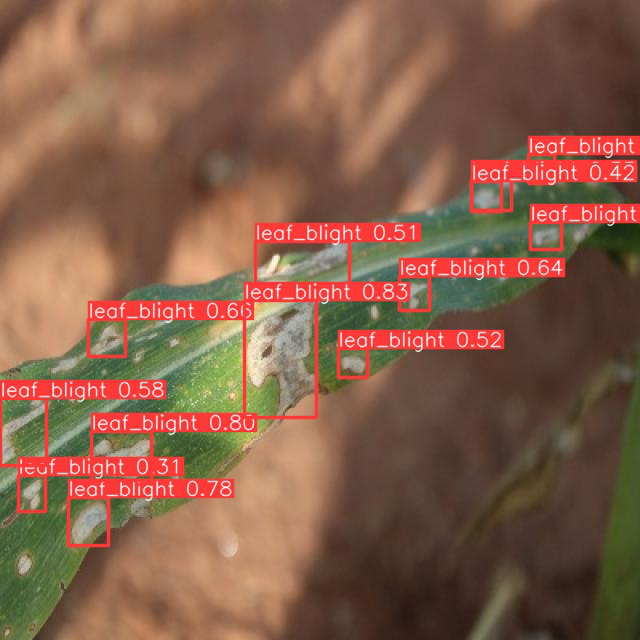

In [63]:
tpath = r"C:\Users\lawrenceJICA\Desktop\DL_plant_diseases_project\model_3\runs\detect\predict4"
images = [f for f in os.listdir(tpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(tpath, images[6])))

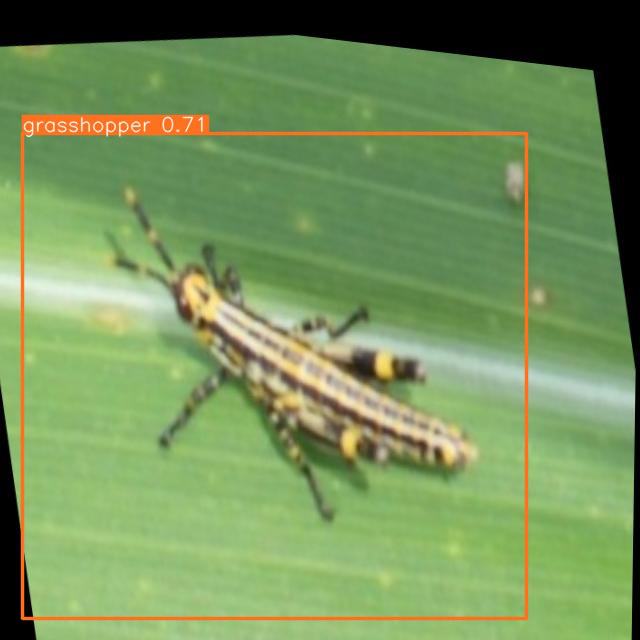

In [64]:
images = [f for f in os.listdir(tpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(tpath, images[4])))

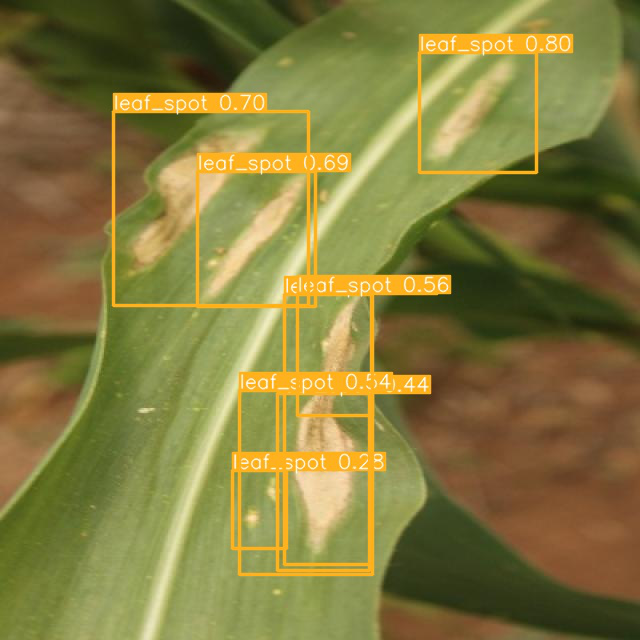

In [65]:
images = [f for f in os.listdir(tpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(tpath, images[9])))

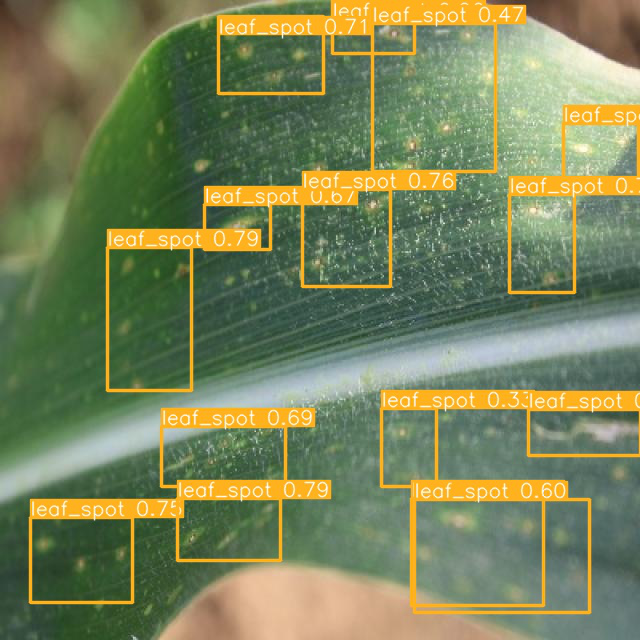

In [66]:
images = [f for f in os.listdir(tpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(tpath, images[10])))

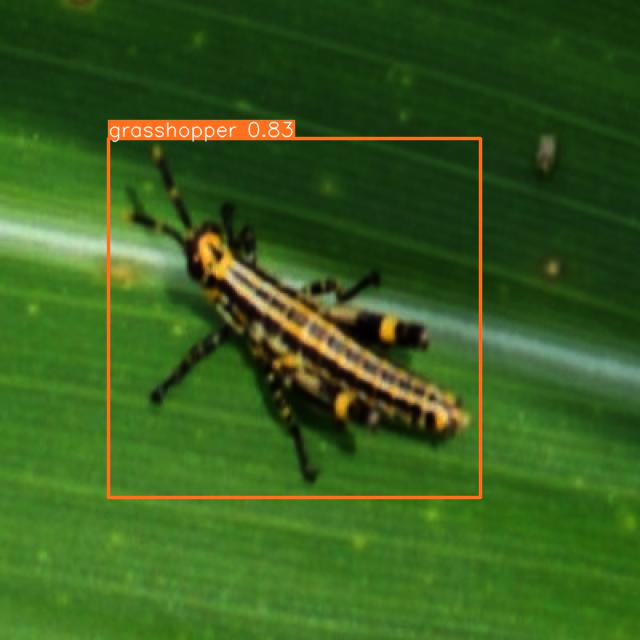

In [67]:
images = [f for f in os.listdir(tpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(tpath, images[3])))

### Footer

In [68]:
Message = '''
cc: Dominic Ocharo and Shadrack Ian Onjiri
year: 2023
School Project JkKUAT
'''
print(Message)


cc: Dominic Ocharo and Shadrack Ian Onjiri
year: 2023
School Project JkKUAT



In [69]:
print("---------------DONE---------------")

---------------DONE---------------
